In [210]:
from IPython.core.display import display, HTML

display(HTML("<style>.container { width:80% !important; }</style>"))

### Данные для построения приложены к домашнему заданию (data.csv)

Привет! В этом задании тебе предстоит построить модель для задачи предсказания дефолта клиента. Тебе предоставлен набор признаков и целевая переменная — факт выхода клиентов в просрочку глубины 4 на горизонте 12 месяцев. Нужно провести анализ признаков и выявить наиболее релевантные к задаче, проанализировать их и простроить линейную модель. Этот проект не имеет жестких ограничений на многие пункты и допускает во многом **вольный подход** к его выполнению: например, мы предлагаем самостоятельно выбрать подход к заполнению пропущенных значений и не накладываем никаких ограничений. Таких пунктов в этом проекте много, цель проста: проанализировать то, как ты **самостоятельно** принимаешь решения. Единственное, советуем **аргументировать** свои решения и стараться **интепретировать** полученные результаты, аргументация будет также учтена при оценивании работы. 

### Как будет оцениваться ваша работа: 
Все пункты (1-12) весят одинаково, итоговая оценка — количество правильно выполненных пунктов. В случае отсутствия аргументации/выводов за пункт ставится 0.5 

### Задание
0. Разбейте выборку на train, val, test (обучение и анализ модели проводите на train). Разбиение аналогично тому, что проводилось на семинаре (60/20/20, без шаффла). В случае иного разбиения модель качество модели будет считаться **невалидным**. 
1. Исследуйте и  заполните пропуски, **обоснуйте** метод и выскажете свои предположения о возможных причинах их появления
2. Отберите все признаки по ROC-AUC > 0.525
3. Проведите EDA для трёх самых сильных признаков. Как думаете, как **интерпретировать** эти зависимости? (https://en.wikipedia.org/wiki/Exploratory_data_analysis)
4. Постройте матрицу корреляций, удалите все сильные корреляты, поясните свой выбор
5. Настройте градиентный бустинг так, чтобы на тесте качество было не меньше **0.646** (тест никак не должен участвовать в настройке модели) (https://lightgbm.readthedocs.io/en/latest/pythonapi/lightgbm.LGBMClassifier.html)
6. Визуализируйте 7 самых сильных признаков по gain (https://lightgbm.readthedocs.io/en/latest/pythonapi/lightgbm.plot_importance.html) Как думаете, **как работает** самый сильный признак? Почему?(больше -> лучше, меньше -> лучше)
7. Реализуйте функцию **stepwise** для логистической регрессии
8. Отберите признаки с порогами 10 и 15% 
9. Обучите логистическую регрессию на признаках, **отобранных** по stepwise
9. Визуализируйте силу признаков линейной модели
10. Сильно ли различается результат по сравнению с бустингом? Как думаете, **почему**?
11. Посчитайте **на тесте** ROC-AUC вашей модели, как считаете, не переобучилась ли она?

### Описание признаков

1. max_util (максимальная утилизация по КК)
2. avg_util (средняя утилизация по КК)
3. credits_2y (количество кредитов за последние 2 года)
4. credits_4y (количество кредитов за последние 4 года)
5. bad_history_credits_flg (наличие кредитов в подозрительных кредитных организациях)
6. other_util (отношение задолженности к сумме кредитов в других организациях)
7. avg_term (средний срок кредита)
8. min_term (минимальный срок кредита)
9. avg_limit_mortgage (средний лимит по ипотекам)
10. min_limit_mfo (минимальный лимит в мфо)
11. close_balance_amt (выплаченная сумма)
12. soc_dem_score (скоринговый балл основанный на соц-дем показателях)
13. max_delq_cnt (максимальное число просрочек по кредиту)
14. avg_active_time (среднее оставшееся время по открытам кредитам)
15. last_credit_time_years (время (в годах) с последнего закрытого кредита)

### Чек лист готовности работы ('x' чтобы поставить галочку)

- [x]  Признаки отобраны по ROC-AUC
- [x]  EDA проведён
- [x]  Корреляты удалены
- [x]  Градиентный бустинг обучен и достигает нужного качества
- [x]  Самые сильные признаки отобраны
- [x]  Stepwise реализован 
- [x]  Линейная модель обучена, проанализирована сила признаков 
- [x]  Метрики на тесте посчитаны
- [x]  Проведено сравнение качества моделей, выдвинуты гипотезы о причинах наблюдаемых результатов

In [3]:
import importlib
import pandas as pd
import numpy as np
import os
import sys
import pandas as pd
import plotly.io as pio
import seaborn as sns
import plotly.graph_objects as go

from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score, log_loss
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from scipy.stats.distributions import chi2
from matplotlib import pyplot as plt
from scipy.stats import bernoulli, norm
from plotly.subplots import make_subplots
import plotly.express as px

%matplotlib inline

# Functions

В данном разделе, для удобства, будут храниться все функции, используемые во время решения

In [63]:
from sklearn.metrics import roc_auc_score, r2_score


def make_bucket(df, feature, n=100):
    '''функция, бьющая на бакеты(по умолчанию 100 точек)'''
    return df.assign(bucket=np.ceil(df[feature].rank(pct=True) * n))


def fit_predict1(X_train, y_train, X_test, global_woe):
    model = LogisticRegression()
    model.fit(X_train, y_train)
    prediction = model.predict_proba(X_train)
    return prediction, model.intercept_, model.coef_


def woe_val(tar, global_woe, iv, g_t, g_f):
    woe = np.log((sum(tar)) / (tar.shape[0] - sum(tar) + 1)) - global_woe
    iv += woe * ((sum(tar) / g_t) - (tar.shape[0] - sum(tar)) / g_f)
    return woe, iv


def woe_line(x, y, n_buckets):
    """ Строит график зависимости WoE
    x - параметр, от которого стоит искать зависимость
    y - метки класса (0 / 1)
    n_buckets - количество бинов для вещественного признака
    feature_name, target_name - подписи к графику
    """
    ind = np.argsort(x.reshape(-1))
    size = len(x) // n_buckets
    grouped = []
    med_var = []
    mini = []
    maxi = []
    woe = []
    iv = 0
    df = pd.DataFrame()
    df['tar'] = y
    df['var'] = x
    df = make_bucket(df, 'var', n_buckets)

    g_t = sum(y)
    g_f = y.shape[0] - g_t

    new_nbins = df['bucket'].nunique()

    global_woe = np.log((sum(df['tar'].values)) /
                        (df['tar'].shape[0] - sum(df['tar'].values) + 1))

    bucks = np.sort(df['bucket'].unique())

    for t in bucks:
        mini.append(np.min(df['var'][df['bucket'] == t]))
        maxi.append(np.max(df['var'][df['bucket'] == t]))
        med_var.append(np.median(df['var'][df['bucket'] == t]))
        w, iv = woe_val(df['tar'][df['bucket'] == t].values, global_woe, iv,
                        g_t, g_f)
        woe.append(w)
        df['bucket'] = df['bucket'].replace(
            t, f"{round(mini[-1],3)}...{round(maxi[-1])}")

    alpha = (med_var[-1] - med_var[0]) / 100

    pred, inter, coef = fit_predict1(
        x, y,
        np.array([med_var[0] - 5 * alpha] + med_var +
                 [med_var[-1] + 5 * alpha]).reshape(-1, 1), global_woe)

    plt.figure(figsize=(15, 7))

    plt.grid()
    plt.plot(med_var, woe, 'o', color='red')
    line_tar = plt.plot(med_var, woe, color='red', linestyle='--', label="Woe")

    log_reg1 = plt.plot([med_var[0], med_var[-1]], [
        med_var[0] * coef[0] + inter - global_woe,
        med_var[-1] * coef[0] + inter - global_woe
    ],
                        label="Interpolation")

    plt.legend(fontsize=12,
               loc='lower right',
               fancybox=True,
               framealpha=1,
               shadow=True)
    xmin, xmax = plt.xlim()
    ymin, ymax = plt.ylim()

    print("IV : ", round(iv, 4))
    print("AUC : ", round(roc_auc_score(y, pred[:, 1]), 4))
    print("n_buckets :", n_buckets)
    print("The point where woe is zero : ",
          round(((global_woe - inter) / coef[0])[0], 4))
    print(
        "R_sqr : ",
        round(
            r2_score(
                woe,
                list(map(lambda x: coef[0] * x + inter - global_woe,
                         med_var))), 4))

    plt.xlabel("Feature", fontsize=20)
    plt.ylabel("WoE", fontsize=20)
    plt.grid()
    plt.show()

    fig = px.histogram(df, x='var', y='tar', color='bucket')
    fig.show()

Функция preprocess нужна для единной обработки данных (Заполнения пропусков, обрезание выбрасов и т.д.). Она будет пополняться по мере выполнения заданий

In [141]:
def f_0(x):
    """
    Функция нужна, чтобы избавиться от отрицательных значений 
    для переменных,
    где такое значение не предусмотрено
    """
    if x < 0:
        return 0
    return x


def preprocess(df):
    """
    Функция для преобразования признаков
    
    Parameters
    ----------
    df : DataFrame
        датафрейм с наблюдениями и целевой переменной


    Returns
    ---
    df: DataFrame 
        датафрейм с преобразованными признаками
    """

    # Заполнение пропусков
    df['avg_active_time'] = df['avg_active_time'].fillna(108.3456)
    df['min_term'] = df['min_term'].fillna(3.628)
    df['avg_term'] = df['avg_term'].fillna(91.501)

    for neg in ['avg_term', 'min_term', 'avg_active_time']:
        df[neg] = df[neg].apply(f_0)

    # Немного обрежем каждую переменную, из-за того, что некоторые из них имеют сильные выбросы
    df['avg_term'] = df['avg_term'].clip(
        lower=np.percentile(df['avg_term'], 0),
        upper=np.percentile(df['avg_term'], 99.5))
    
    df['min_term'] = df['min_term'].clip(
        lower=np.percentile(df['min_term'], 0),
        upper=np.percentile(df['min_term'], 95))
     
    features1 = features = [
    'max_util', 
    'avg_util',
    'credits_2y',
    'credits_4y',
    'bad_history_credits_flg',
    'other_util', 
    'avg_limit_mortgage',
    'min_limit_mfo', 
    'close_balance_amt',
    'soc_dem_score',
    'max_delq_cnt',
    'avg_active_time',
    'last_credit_time_years']
    
    for feat in features1:
        df[feat] = df[feat].clip(lower=np.percentile(df[feat], 1),
                                 upper=np.percentile(df[feat], 99))
    return df

In [164]:
from sklearn import model_selection, datasets, metrics, tree, ensemble
def fit_and_metrics(estimator, train_data, train_labels, test_data, test_labels):
    estimator.fit(train_data, train_labels)

    
    predictions = estimator.predict_proba(train_data)
    print(f'Train: {round(metrics.roc_auc_score(train_labels, predictions[:,1]), 5)}')
    
    predictions = estimator.predict_proba(test_data)
    print(f'Validation: {round(metrics.roc_auc_score(test_labels, predictions[:,1]), 5)}')
    
    return estimator

def plot_train_test_metrics(model_nm, train_list, test_list, n_max):
    plt.figure(figsize=(8,6))
    plt.title(model_nm)
    plt.plot(range(1, n_max + 1), train_list, label='Train')
    plt.plot(range(1, n_max + 1), test_list, label='Test')
    plt.xlabel('Number of config')
    plt.ylabel('MSE')
    plt.legend()
    plt.grid(True)
    plt.show()



In [6]:
def test_val_split(df, val_size=0.2, test_size=0.2):
    
    """
        Функция для разбиения выборки на три части по времени (hold-out подход)
        
        Parameters
        ----------
        df : DataFrame
            датафрейм с наблюдениями и целевой переменной
        val_size : str
            размер валидационной выборки
        test_size : str
            размер тестовой выборки

        Returns
        ---
        df : pandas.DataFrame
           исходный датафрейм с новой колонкой sample_part принимающей три значения:
           'train', 'val', 'test'

    """
    
    X_train, X_test, y_train, y_test = train_test_split(
        df[features], df['d4p12'], test_size=val_size+test_size, shuffle=False)
    df.assign(sample_part='')
    df.loc[X_test.index, 'sample_part'] = 'test'
    X_val, X_test, y_val, y_test = train_test_split(
        df[features][df['sample_part'] == 'test'], df['d4p12'][df['sample_part'] == 'test'],\
        test_size=test_size / (test_size + val_size), shuffle=False)
    df.loc[X_val.index, 'sample_part'] = 'validation'
    df.loc[X_train.index, 'sample_part'] = 'train'
    return df

# HomeWork

### Задание 0

In [4]:
features = [\
    'max_util', 
    'avg_util',
    'credits_2y',
    'credits_4y',
    'bad_history_credits_flg',
    'other_util', 'avg_term',
    'min_term',
    'avg_limit_mortgage',
    'min_limit_mfo', 
    'close_balance_amt',
    'soc_dem_score',
    'max_delq_cnt',
    'avg_active_time',
    'last_credit_time_years'
]

Для начала заметим, что некоторые строчки дублируются, их лучше удалить, чтобы итоговая модель не переобучилась на них. Также заметим  интересную строчку, только у неё таргет равен -20, хотя должен быть  $ {0,1}$
, а также большинство значений пропущено. Можно считать данную строчку, полученной в результате каких-то проблем, поэтому можно от неё избавиться. 

In [56]:
df = pd.read_csv('scoring_model_data-1-8269f14b-5b6e-4055-8248-9d7ac7243cac.csv')

# Удаляем строчку
df.drop([222275], inplace=True)

# Удаляем дубликаты
Dup_Rows = df[df.duplicated()]
df = df.drop_duplicates(keep=False)

# Сортируем по user_id (также по дате) и разбиваем train/val/test
df = df.sort_values(by=['user_id'])
df = test_val_split(df)

### Задание 1 

Посмотрим на общее количество пропусков в каждом столбце

In [57]:
df.isna().sum()

user_id                        0
d4p12                          0
month_dt                       0
max_util                       0
avg_util                       0
credits_2y                     0
credits_4y                     0
bad_history_credits_flg        0
other_util                     0
avg_term                      38
min_term                      38
avg_limit_mortgage             0
min_limit_mfo                  0
close_balance_amt              0
soc_dem_score                  0
max_delq_cnt                   0
avg_active_time            13257
last_credit_time_years         0
sample_part                    0
dtype: int64

У нас есть 3 признака с пропусками. $$$$ 
avg_term и min_term имеют небольшое, по сравнению с размером данных, количество пропусков, но что более интересно, это то что пропуски для этих столбцов находяться в одних и тех же строчках, значит эти пропуски ,скорее всего, имеют одну природу, а также эти строчки встречаются почти в каждом месяце, значит это вряд ли пропуски из-за внезапного сбоя в какой-то день. Также, эти строчки не имеют явно выраженных особенностей, как мне кажется, данные пропуски появились случайно. Поэтому, я решил их заполнить значением, при котором woe для этих признаков равен нулю. 

Woe для признака min_term, занесем полученное значение в функцию preprocess

IV :  0.0009
AUC :  0.5003
n_buckets : 20
The point where woe is zero :  3.628
R_sqr :  0.4308


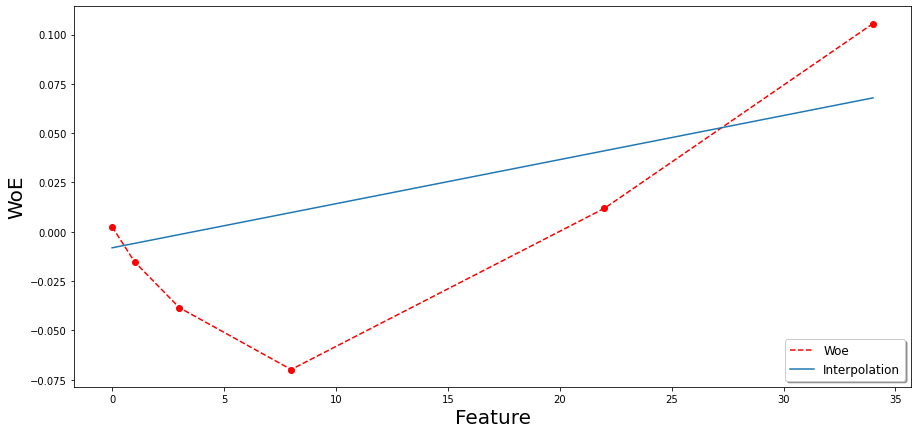

In [139]:
import plotly.express as px

#Ограничим отрицательные значения нулем
def f1(x):
    if x < 0:
        return 0
    return x


woe_line(
    df['min_term'][df['min_term'].isna() == False].clip(
        lower=np.percentile(df['min_term'][df['min_term'].isna() == False], 1),
        upper=np.percentile(df['min_term'][df['min_term'].isna() == False],
                            95)).apply(f1).astype('float64').values.reshape(-1, 1),
    df['d4p12'][df['min_term'].isna() == False],
    n_buckets=20,
)

Woe для признака avg_term, занесем полученное значение в функцию preprocess

IV :  0.0098
AUC :  0.5231
n_buckets : 20
The point where woe is zero :  91.501
R_sqr :  0.5888


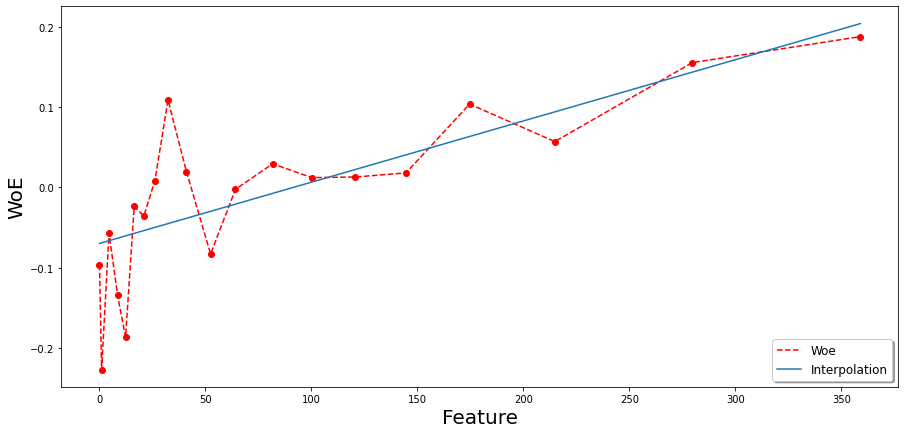

In [133]:
def f2(x):
    #Ограничим отрицательные значения нулем
    if x < 0:
        return 0
    return x


woe_line(
    df['avg_term'][df['avg_term'].isna() == False].clip(
        lower=np.percentile(df['min_term'][df['min_term'].isna() == False], 0),
        upper=np.percentile(df['min_term'][df['min_term'].isna() == False],
                            99.5)).astype('float64').apply(f2).values.reshape(
                                -1, 1),
    df['d4p12'][df['avg_term'].isna() == False],
    n_buckets=20,
)

Последний признак с пропусками - это avg_active_time. Этот признак в отличии от двух предыдущих имеет уже большое количество пропусков и неправильное их заполнение может уже привести к ухудшению результата. Заметим интересную закономерность. Для всех наблюдений с пропусками, min_limit_mfo и avg_limit_mortgage равны -1, такая закономерность, как мне кажется, не слуйчна, так как все 3 признака так или иначе связаны друг с другом и можно выдвинуть гипотезу о том, что люди которые не имели дел с мфо и ипотеками и имеют значение для этих признаков -1, имеют характерные особенности и тем самым имеют схожее значение avg_active_time, поэтому я принял решение заполнить все пропуски среднем значением avg_active_time по строчкам, где min_limit_mfo и avg_limit_mortgage = -1. Я получил значение 108.3456.

In [113]:
print(df[df['avg_active_time'].isna()]['avg_limit_mortgage'].unique())
print(df[df['avg_active_time'].isna()]['min_limit_mfo'].unique())

[-1.]
[-1.]


In [218]:
print(df[(df['avg_limit_mortgage'] == -1) & (df['min_limit_mfo'] == -1)][
    df1['avg_active_time'].isna() == False]['avg_active_time'].mean())

108.34558970820628


Заметим, что у некоторых признаков присутствуют отрицательные значения, хотя исходя из их описания, такие значения быть не могут, поэтому это нужно учесть. Я попробовал несколько способов, заменить такие значения на 0, как нижнюю допустимую границу и применить модуль, из тех соображений, что таким отрицательным значениям могут соответствовать положительные, а занесены они были в таком формате из-за сбоя, невнимательности или другой проблемы. Но оказалось, что оба подхода дают схожие результаты, поэтому я остановился на замене их нулем. Занесём это преобразование в preprocess.

In [221]:
df = preprocess(df)

### Задание 2

In [143]:
def filter_by_score(df, features=None, target='d4p12', score=roc_auc_score, greater_is_better=True, top_n=10):
    
    """
        Функция для фильтрации признаков по заданной метрике качества

        Parameters
        ----------
        df : DataFrame
            датафрейм с наблюдениями и целевой переменной
        features : str
            список переменных для фильтрации
        target : str
            целевая переменная 
        score : func
            функция формата func(y_true, y_pred) по которой будут отбираться признаки
            по умолчанию используется sklearn.metrics.roc_auc_score
        greater_is_better: bool
            если ваша метрика — score (больше -> лучше), тогда True, если loss (меньше -> лучше),  
            используйте False
        top_n : int
            количество самых лучших признаков с точки зрения метрики
            
        Returns
        ---
        object : pandas.Series
           Series с top_n лучшими признаками с точки зрения score

    """
    if not features:
        features = set(df.select_dtypes(include=['float64']).columns)
    metrics = {}
    for feature in features:
        mask = (df[target].notna()) & (df[feature].notna())
        metrics[feature] = max(roc_auc_score(df[target][mask], df[feature][mask]), 1-roc_auc_score(df[target][mask], df[feature][mask]))
    if greater_is_better:
        return pd.Series(metrics).sort_values(ascending=False).head(n=top_n)
    return pd.Series(metrics).sort_values(ascending=True).head(n=top_n)

In [144]:
features_rate = filter_by_score(df, features, top_n=len(features))
features_rate = features_rate[features_rate>0.525]

In [147]:
features_rate = [
    "max_util", "soc_dem_score", "avg_util", "other_util",
    "last_credit_time_years", "credits_4y", "credits_2y", "avg_limit_mortgage",
    "close_balance_amt", "min_limit_mfo", "avg_term", "avg_active_time"
]

### Задание 3

In [149]:
best_3 = features_rate[:3]

In [150]:
best_3

['max_util', 'soc_dem_score', 'avg_util']

Alert! from version 0.1.38. After importing, you must do '%matplotlib inline' to display charts in Jupyter Notebooks.
    AV = AutoViz_Class()
    AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not display plots but saves them in AutoViz_Plots folder in local machine.
Updated: chart_format='bokeh' generates and displays charts in your local Jupyter notebook.
      chart_format='server' generates and displays charts in the browser - one tab for each chart.
      chart_format='html' silently saves charts HTML format - they are also interactive!


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
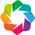

In [155]:
from autoviz.AutoViz_Class import AutoViz_Class

Для первичного EDA я выбрал AutoViz, он включает в себя построенние всех необходимых графиков.

Не используя таргет

Shape of your Data Set loaded: (214016, 3)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
Data Set Shape: 214016 rows, 3 cols
Data Set columns info:
* max_util: 0 nulls, 158175 unique vals, most common: {0.0: 20562, 1.0: 12026}
* soc_dem_score: 0 nulls, 209736 unique vals, most common: {-2.0917789336152537: 2141, -10.233862146482: 2141}
* avg_util: 0 nulls, 189138 unique vals, most common: {0.0: 20562, 1.0001976983024692: 2141}
--------------------------------------------------------------------
    Numeric Columns: ['max_util', 'soc_dem_score', 'avg_util']
    Integer-Categorical Columns: []
    String-Categorical Columns: []
    Factor-Categorical Columns: []
    String-Boolean Columns: []
    Numeric-Boolean Columns: []
    Discrete String Columns: []
    NLP text Columns: []
    Date Time Columns: []
    ID Columns: []
    Columns that will not be considered in modeling: []
    3 Predictors classified...
        No

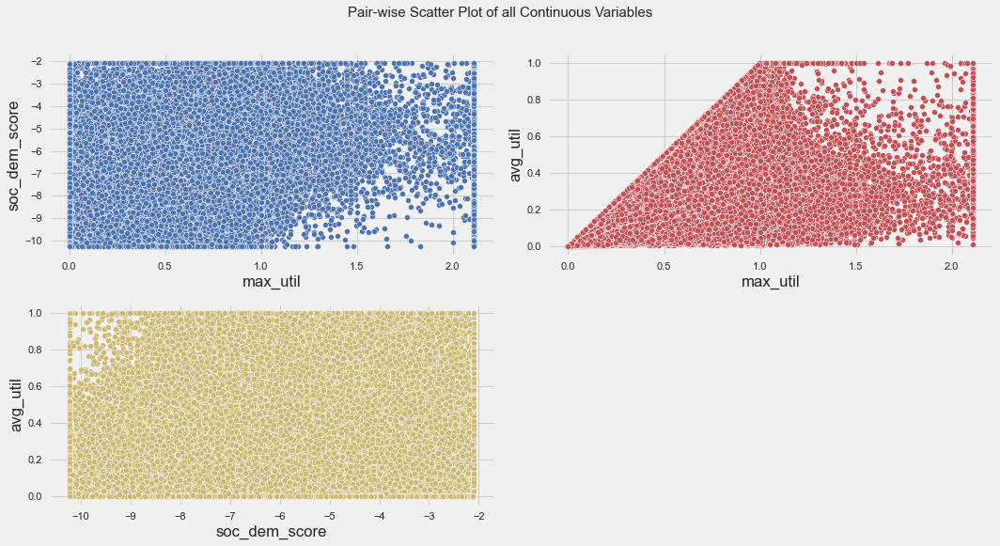

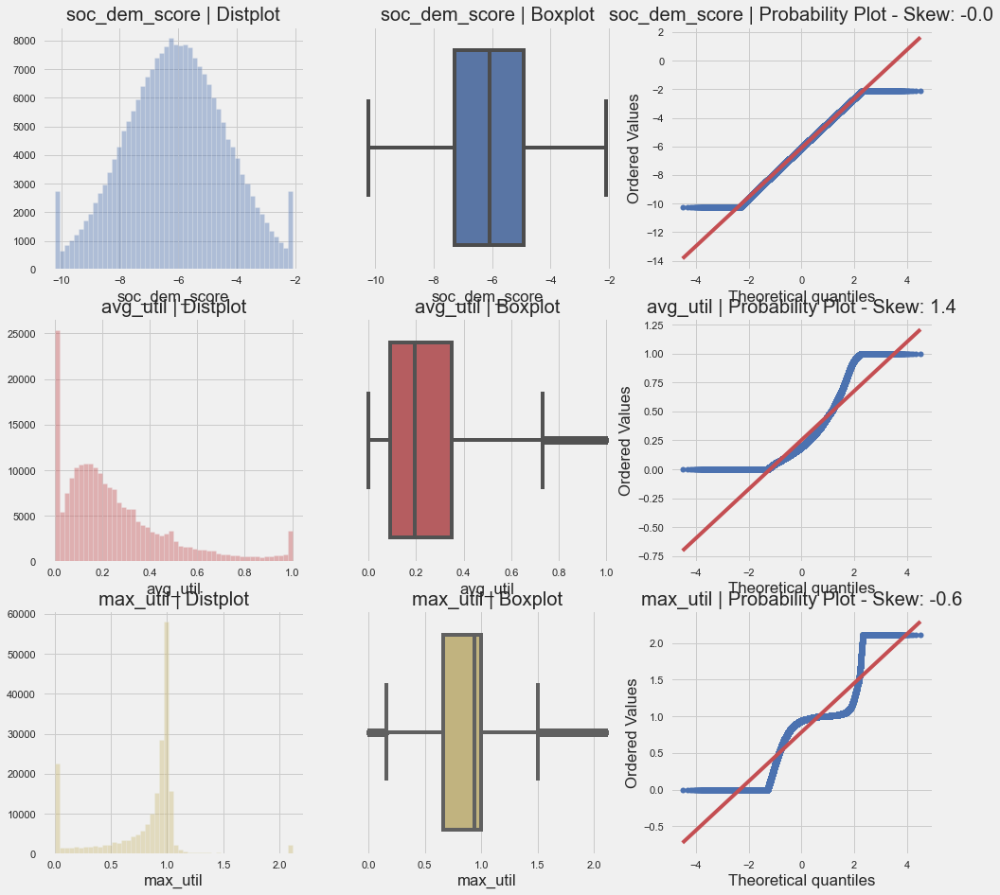

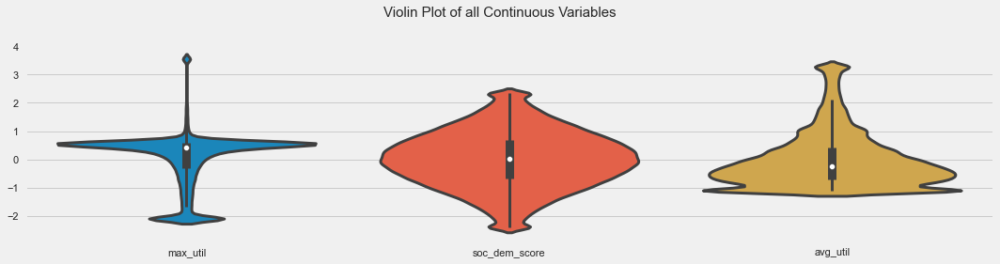

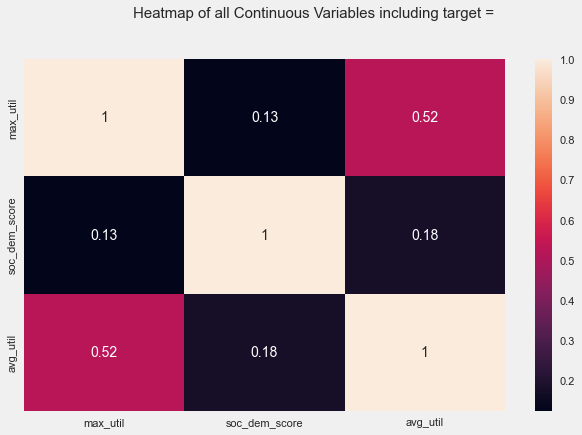

In [158]:
AV = AutoViz_Class()
df2 = AV.AutoViz(filename="",sep=',', dfte=df[['max_util', 'soc_dem_score', 'avg_util']], header=0, verbose=2, 
                 lowess=False, chart_format='svg', max_rows_analyzed=250000, max_cols_analyzed=4)

Используя таргет

Shape of your Data Set loaded: (214016, 4)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
Data Set Shape: 214016 rows, 3 cols
Data Set columns info:
* max_util: 0 nulls, 158175 unique vals, most common: {0.0: 20562, 1.0: 12026}
* soc_dem_score: 0 nulls, 209736 unique vals, most common: {-2.0917789336152537: 2141, -10.233862146482: 2141}
* avg_util: 0 nulls, 189138 unique vals, most common: {0.0: 20562, 1.0001976983024692: 2141}
--------------------------------------------------------------------
    Numeric Columns: ['max_util', 'soc_dem_score', 'avg_util']
    Integer-Categorical Columns: []
    String-Categorical Columns: []
    Factor-Categorical Columns: []
    String-Boolean Columns: []
    Numeric-Boolean Columns: []
    Discrete String Columns: []
    NLP text Columns: []
    Date Time Columns: []
    ID Columns: []
    Columns that will not be considered in modeling: []
    3 Predictors classified...
        No

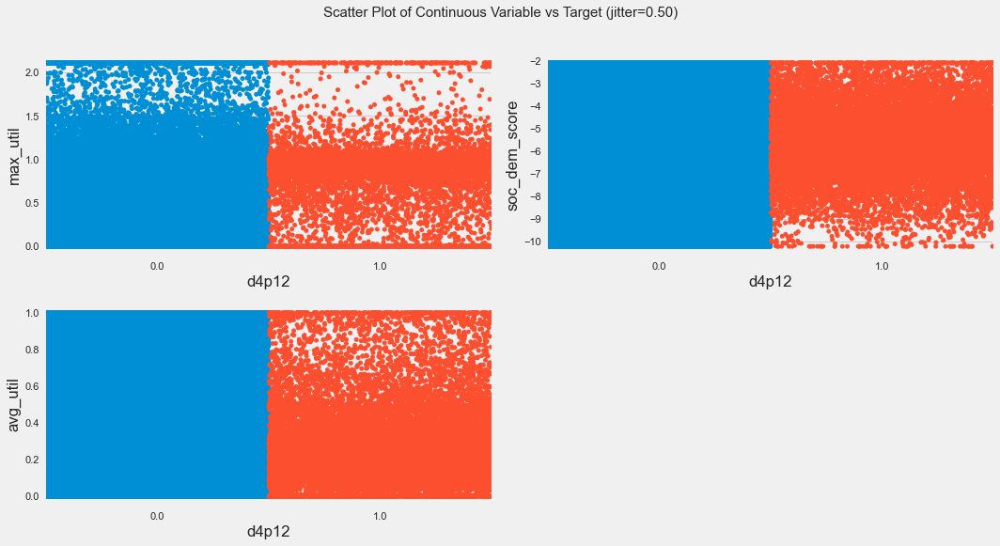

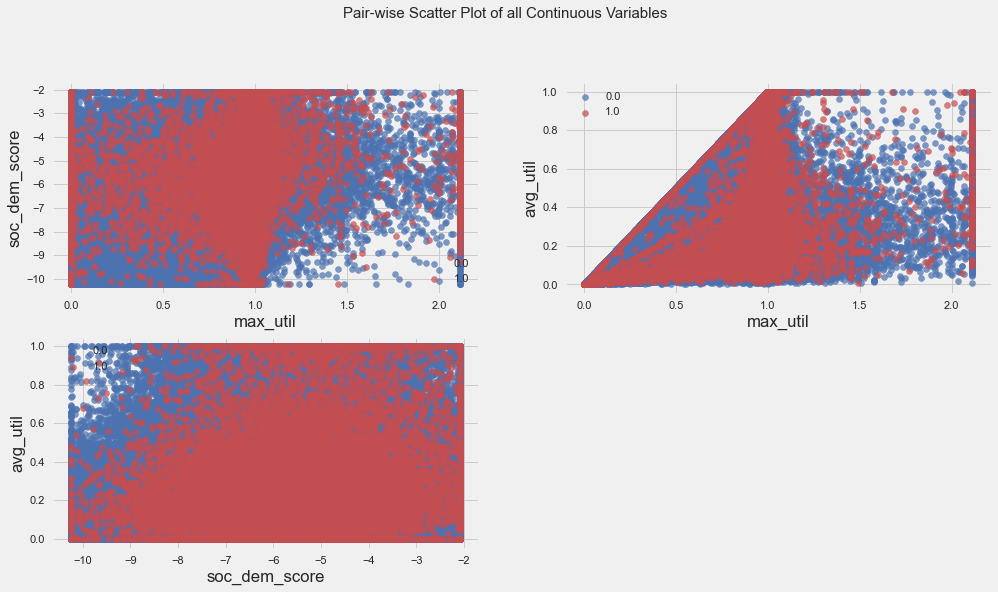

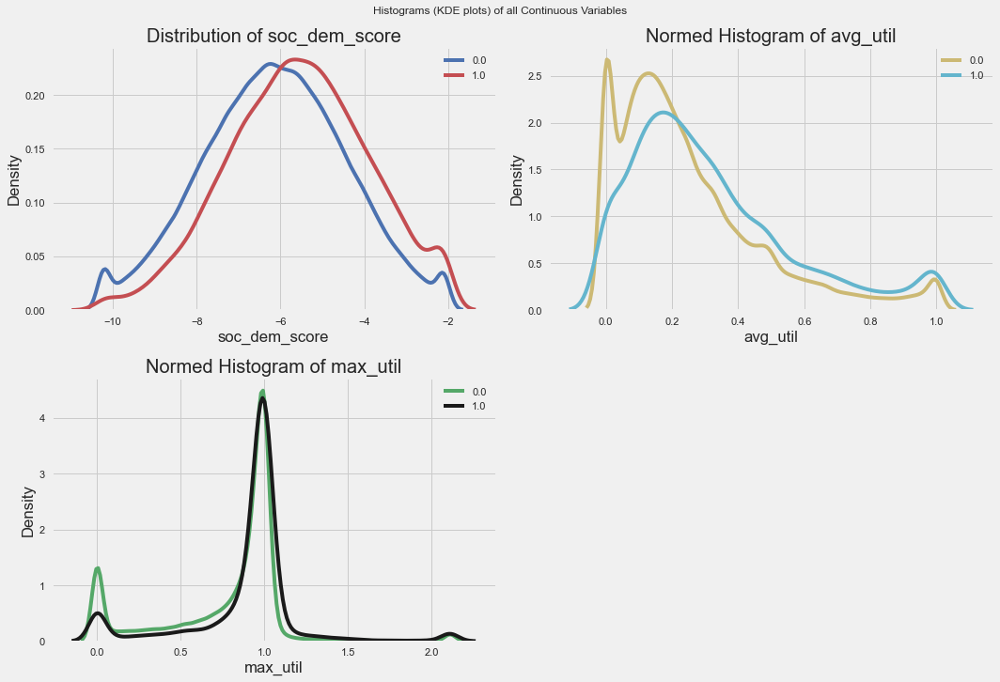

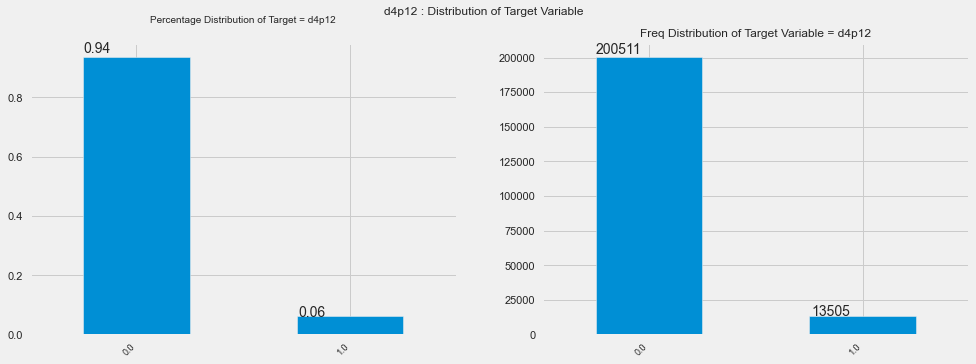

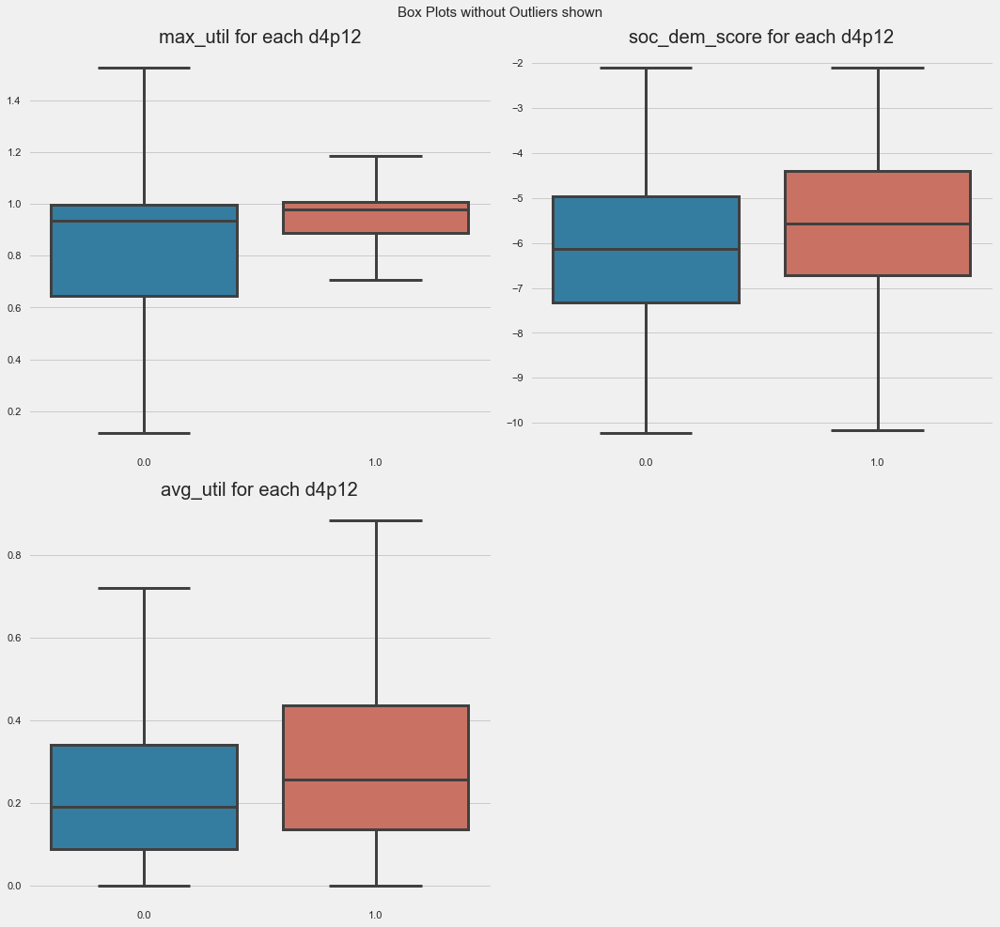

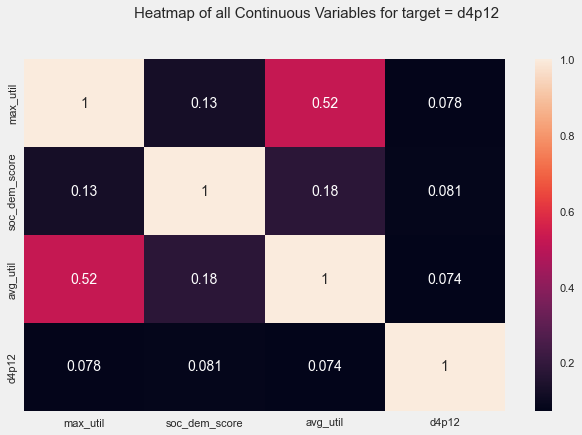

In [157]:
AV = AutoViz_Class()
df1 = AV.AutoViz(filename="",sep=',', depVar='d4p12', dfte=df[['max_util', 'soc_dem_score', 'avg_util','d4p12']], header=0, verbose=2, 
                 lowess=False, chart_format='svg', max_rows_analyzed=250000, max_cols_analyzed=4)

Из графиков можно заметить, что какой-то явной зависимости между max_util и soc_dem_score нет, как её нет и для soc_dem_score и avg_util, их парные распределения почти равномерные. В тоже самое время, наблюдается явная зависимость между max_util и avg_util, их парное распределение разделяется прямой. Всё это можно было заметить и при помощи матрицы корреляции. Из интересного, soc_dem_score распределено симметрично вокруг -6, а распределение soc_dem_score при условии таргета, также симметрично но уже с явным смещением в зависимости от таргета. Также если рассмотреть box-plot для каждой переменной при условии таргета, то можно заметить либо уменьшение размаха или смещение перцентилей в зависимости от таргета, что говорит о связи с таргетом. Также, soc_dem_score имеет линейный вид Probability plot (не считая константы по краям), а так же Skew : 0, можно предположить, что soc_dem_score распределен нормальным образом

### Задание 4

В качестве порога выберем стандартное значение равное 0.3. Т.е. сильными коррелятами будем считать признаки у которых значение корреляции по модулю больше 0.3. При удалении я придерживался  интуитивно понятной логики, стараясь оставить как можно больше переменных, оставляя в приоритете признаки с большим значением roc_auc. Так credits_2y , credits_4y  ,last_credit_time_years попарно коррелируют друг с другом, поэтому из 3 должен остаться один признак. Оставляем last_credit_time_years, так как он имеет наибольшее значение roc_auc. Похожая ситуация с признаками avg_util, other_util, max_util, все три признака попарно коррелируют между собой, поэтому оставляем признак с наибольшим roc_auc, т.е. max_util.

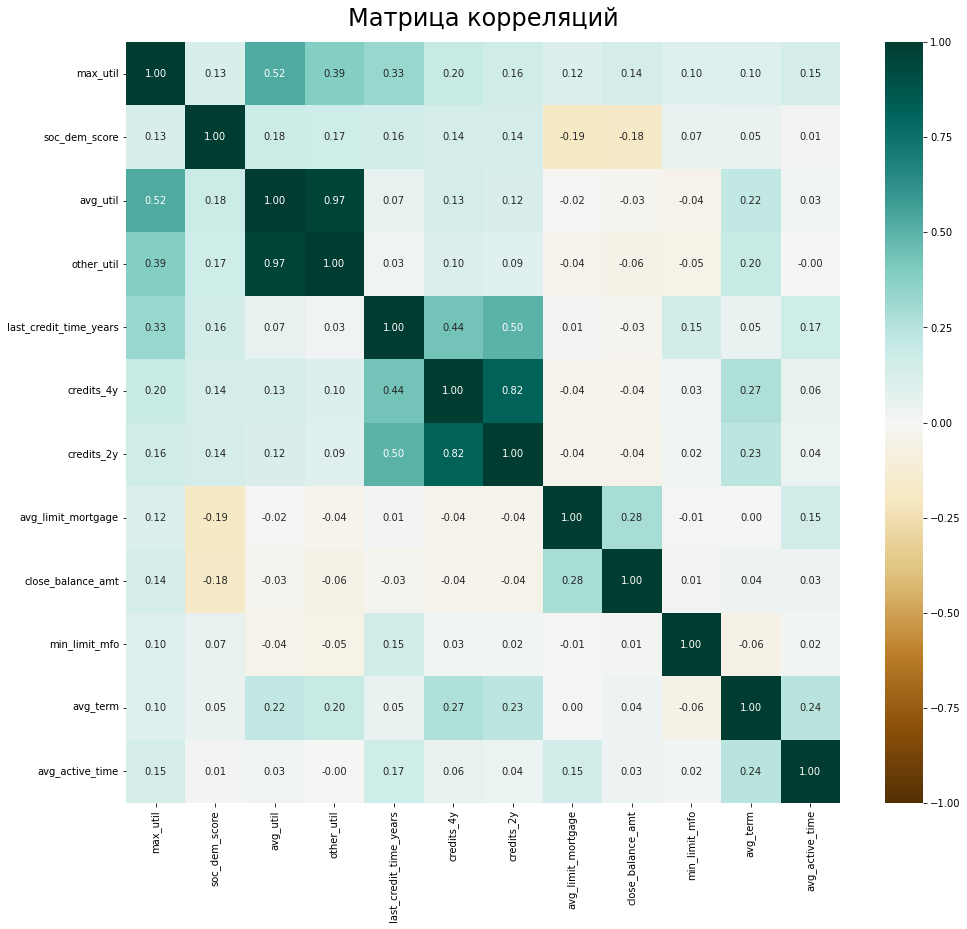

In [151]:
plt.figure(figsize=(16, 14))


heatmap = sns.heatmap(df[features_rate].corr(), mask=None, vmin=-1, vmax=1, annot=True, cmap='BrBG', fmt=".2f")
heatmap.set_title('Матрица корреляций', fontdict={'fontsize':24}, pad=16);

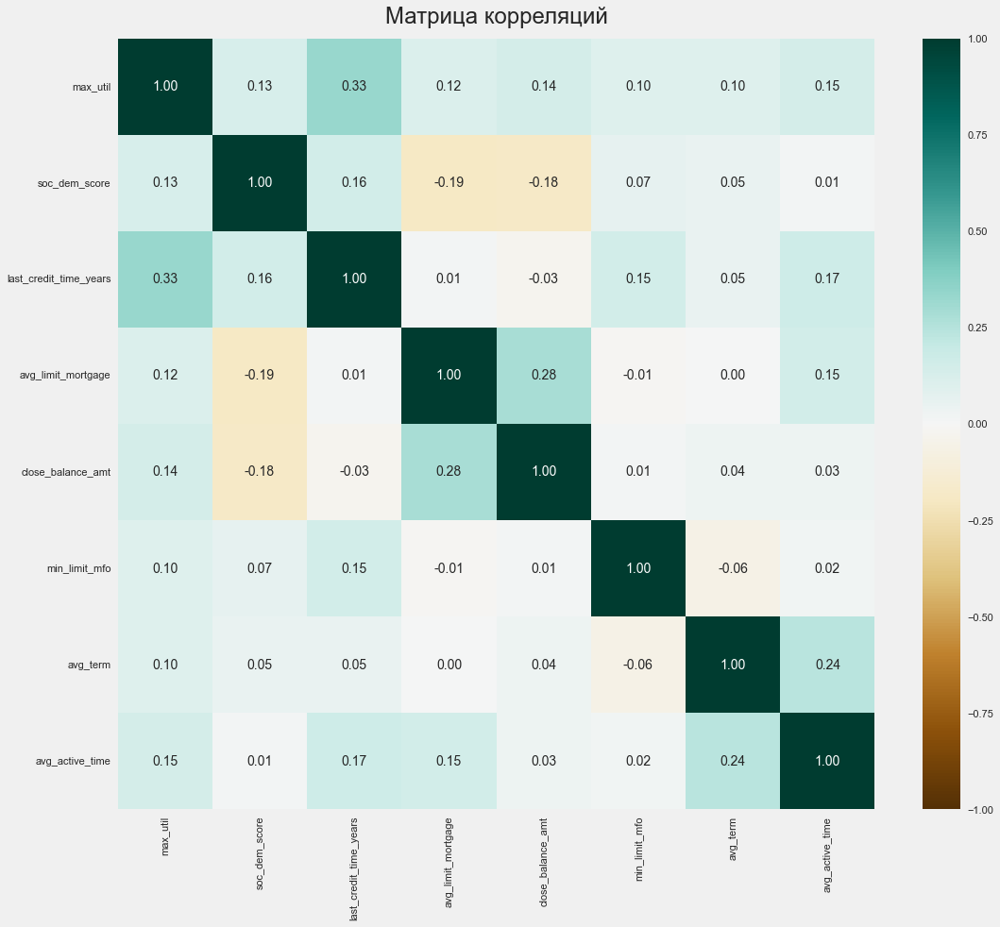

In [163]:
plt.figure(figsize=(16, 14))


heatmap = sns.heatmap(df[new_features].corr(), mask=None, vmin=-1, vmax=1, annot=True, cmap='BrBG', fmt=".2f")
heatmap.set_title('Матрица корреляций', fontdict={'fontsize':24}, pad=16);

Можно заметить, что среди отобранных признаках, есть пара у которой корреляция 0.33, я решил их оставить из-за того, что это значение является почти граничным и оба признака имеют хороший, по сравнению с остальными roc_auc, поэтому я решил, что оба признака пригодяться для построения дальнейших моделей и не испортят процессы их обучения

In [160]:
new_features = ['max_util',
 'soc_dem_score',
 'last_credit_time_years',
 'avg_limit_mortgage',
 'close_balance_amt',
 'min_limit_mfo',
 'avg_term',
 'avg_active_time']   

### Задание 5

In [162]:
import lightgbm as lgb

In [165]:
train_labels = df['d4p12'][df['sample_part'] == 'train']
val_labels = df['d4p12'][df['sample_part'] == 'validation']
test_labels = df['d4p12'][df['sample_part'] == 'test']

train_data = df[features][df['sample_part'] == 'train']
val_data = df[features][df['sample_part'] == 'validation']
test_data = df[features][df['sample_part'] == 'test']

Для подбора гиперпараметров я использовал Optuna, сначала выбрав широкий диапозон Обучения с ("max_depth": trial.suggest_int("max_depth", 2, 12), 'learning_rate': trial.suggest_categorical('learning_rate', np.linspace(0.001,0.1,250)) и так далее), после чего несколько раз обучал на более узких диапозонах, смещенных в сторону лучших результатов. В конечном итоге я выбрал модель с наибольшим показателем на Validation score :0.664, результат на test составил: 0.647, что удовлетворяет поставленной задаче. Итоговые парамметры **{lambda_l1 = 20  , lambda_l2 = 5,  learning_rate  =  0.0934,  max_depth = 4,   min_data_in_leaf = 250, n_estimators = 3500 ,  random_state = 42}**

In [167]:
estimator = lgb.LGBMClassifier(lambda_l1 = 20,lambda_l2 = 5, learning_rate = 0.0934,max_depth = 4, min_data_in_leaf = 250, n_estimators = 3500,random_state = 42)
estimator.fit(train_data,train_labels)

In [169]:
print("Train score:", roc_auc_score(train_labels,estimator.predict_proba(train_data)[:,1]))
print("Validation score:", roc_auc_score(val_labels,estimator.predict_proba(val_data)[:,1]))
print("Test score:", roc_auc_score(test_labels,estimator.predict_proba(test_data)[:,1]))

Train score: 0.7124592442360349
Validation score: 0.6640915547939515
Test score: 0.6473105357967334


###  Задание 6

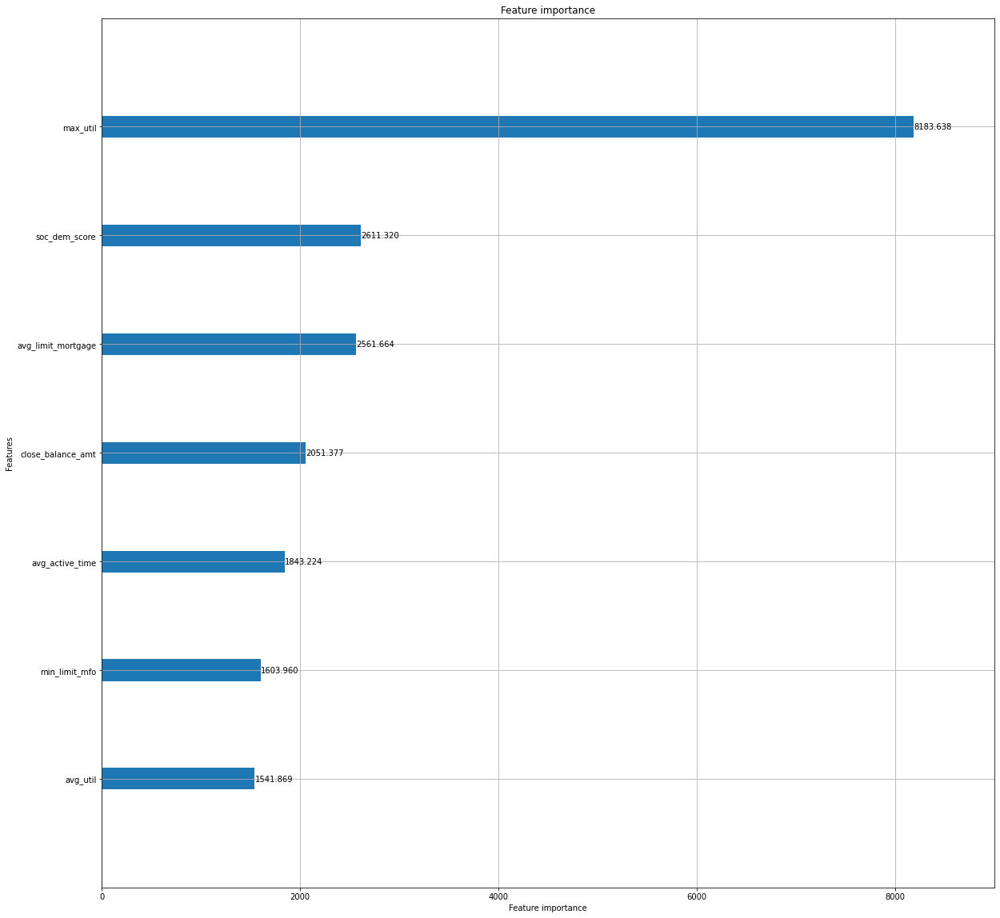

In [41]:
from lightgbm import  plot_importance
plot_importance(estimator, importance_type='gain', max_num_features= 7, figsize=(20, 20), precision=3)
plt.show()

Наилучшим признаком по gain оказался max_util, он значительно превосходит остальные признаки. max_util - это  (максимальная утилизация по КК), т.е. максимальное отношение задолжности к кредиту. А значение importance по gain, это сумма gain при разделении по всем ячейкам, где участвовал данный признак. Из моих личных соображений и исходя из определения max_util, кажется , что чем больше max_util, тем выше вероятность дефолта, это интуитивно понятно, если у человека накапливается большой долг, по отношению к его кредиту, тем вероятнее он не выполнит свои обязательства в дальнейшем.

### Задание 7

Для реализации stepwise_selection я взял forward_selection, а так же реализовал backward_selection, а так же добавил параметр first, который при значении True выдает только первый признак, т. е. признак с минимальным или максимальным p_value соответственно.

In [170]:
def likelihood_ratio_test(ll_short, ll_long):
    
    """
    вспомогательная функция
    рассчитывает значение p-value для теста отношения правдоподобия
    ll_short — логарифм правдоподобия "короткой" модели
    ll_long — логарифм правдоподобия "длинной" модели

    Returns
    -----
    p-value
    """
    lr = 2 * (ll_short - ll_long)
    return chi2.sf(lr, 1)

In [171]:
def forward_selection(df, features, target='d4p12', alpha=0.05, first=False):
    """
    Функция для отбора признаков при помощи прямого прохода 
    
    Parameters
    ----------
    df : DataFrame
        датафрейм с наблюдениями и целевой переменной
    val_size : str
        размер валидационной выборки
    test_size : str
        размер тестовой выборки

    Returns
    ---
    selected_features : list
        список переменных отобранных на заданном уровне значимости alpha 
    """

    selected_features = list()
    n = df.shape[0]
    p_value = 1
    while True:
        potential_features = list(set(features) - set(selected_features))
        best_feature = ''
        for feature in potential_features:
            temp_features = [feature] + selected_features
            lr_short = LogisticRegression(penalty='none', max_iter=500)
            lr_long = LogisticRegression(penalty='none', max_iter=500)
            if len(selected_features) == 0:
                const = pd.Series([1] * df.shape[0])
                lr_short.fit(np.array(const).reshape(-1, 1), df[target])
                ll_short = log_loss(df[target],
                                    lr_short.predict_proba(
                                        np.array(const).reshape(-1, 1))[:, 1],
                                    normalize=False)
                lr_long.fit(
                    np.array(df[temp_features]).reshape(-1, 1), df[target])
                ll_long = log_loss(df[target],
                                   lr_long.predict_proba(
                                       np.array(df[temp_features]).reshape(
                                           -1, 1))[:, 1],
                                   normalize=False)
            else:
                lr_short.fit(df[selected_features], df[target])
                ll_short = log_loss(df[target],
                                    lr_short.predict_proba(
                                        df[selected_features])[:, 1],
                                    normalize=False)
                lr_long.fit(df[temp_features], df[target])
                ll_long = log_loss(df[target],
                                   lr_long.predict_proba(df[temp_features])[:,
                                                                            1],
                                   normalize=False)
            if likelihood_ratio_test(
                    ll_short, ll_long) < alpha and likelihood_ratio_test(
                        ll_short, ll_long) < p_value:
                p_value = likelihood_ratio_test(ll_short, ll_long)
                best_feature = feature
        if best_feature == '':
            break
        selected_features.append(best_feature)
        print(
            f"В модель была добавлена переменная {best_feature}, p-value: {round(p_value, 4)}"
        )
        if first:
            return best_feature
        p_value = 1
    return selected_features

In [172]:
def backward_selection(df, features, target='d4p12', alpha=0.05, first=False):
    """
    Функция для отбора признаков при помощи прямого прохода 
    
    Parameters
    ----------
    df : DataFrame
        датафрейм с наблюдениями и целевой переменной
    val_size : str
        размер валидационной выборки
    test_size : str
        размер тестовой выборки

    Returns
    ---
    selected_features : list
        список переменных отобранных на заданном уровне значимости alpha 
    """

    selected_features = features.copy()
    n = df.shape[0]
    p_value = 0
    while True:
        potential_features = selected_features.copy()
        worst_feature = ''
        for feature in potential_features:
            temp_features = list(set(potential_features) - set([feature]))
            lr_short = LogisticRegression(penalty='none', max_iter=500)
            lr_long = LogisticRegression(penalty='none', max_iter=500)

            if len(selected_features) == 1:
                const = pd.Series([1] * df.shape[0])
                lr_short.fit(np.array(const).reshape(-1, 1), df[target])
                ll_short = log_loss(df[target],
                                    lr_short.predict_proba(
                                        np.array(const).reshape(-1, 1))[:, 1],
                                    normalize=False)
                lr_long.fit(
                    np.array(df[selected_features]).reshape(-1, 1), df[target])
                ll_long = log_loss(df[target],
                                   lr_long.predict_proba(
                                       np.array(df[selected_features]).reshape(
                                           -1, 1))[:, 1],
                                   normalize=False)
            else:
                lr_short.fit(df[temp_features], df[target])

                ll_short = log_loss(df[target],
                                    lr_short.predict_proba(
                                        df[temp_features])[:, 1],
                                    normalize=False)

                lr_long.fit(df[selected_features], df[target])
                ll_long = log_loss(df[target],
                                   lr_long.predict_proba(
                                       df[selected_features])[:, 1],
                                   normalize=False)

            if likelihood_ratio_test(ll_short, ll_long) > alpha and likelihood_ratio_test(ll_short, ll_long) > p_value:
                p_value = likelihood_ratio_test(ll_short, ll_long)
                worst_feature = feature

        if worst_feature == '':
            if first:
                print("Из выбранных переменных ничего не удалено")
                return ''
            break
        selected_features.remove(worst_feature)
        print(
            f"Из модели была удалена переменная {worst_feature}, p-value: {round(p_value, 4)}"
        )
        if first:
            return worst_feature
        
        p_value = 0
    return selected_features

In [173]:
def stepwise_selection(df,
                       features,
                       target='d4p12',
                       alpha_in=0.1,
                       alpha_out=0.15):
    features1 = features.copy()
    selected_features = list()
    while len(selected_features) < len(features1):
        new_feature = forward_selection(df,
                                        features1,
                                        target='d4p12',
                                        alpha=alpha_in,
                                        first=True)
        if new_feature == '':
            break
        selected_features.append(new_feature)
        features1.remove(new_feature)

        del_feature = backward_selection(df,
                                         selected_features,
                                         target='d4p12',
                                         alpha=alpha_out,
                                         first=True)
        if del_feature != '':

            selected_features.remove(del_feature)

        if len(features1) == 0:
            break

    return selected_features

###  Задание 8

In [231]:
best_stepwise = stepwise_selection(df, new_features, target='d4p12', alpha_in=0.1, alpha_out=0.15)

В модель была добавлена переменная soc_dem_score, p-value: 0.0
Из выбранных переменных ничего не удалено
В модель была добавлена переменная max_util, p-value: 0.0
Из выбранных переменных ничего не удалено
В модель была добавлена переменная last_credit_time_years, p-value: 0.0
Из выбранных переменных ничего не удалено
В модель была добавлена переменная min_limit_mfo, p-value: 0.0
Из модели была удалена переменная soc_dem_score, p-value: 1.0
В модель была добавлена переменная avg_term, p-value: 0.0
Из выбранных переменных ничего не удалено


### Задание 9

Приведём данные к одному масштабу, чтобы адекватно обучить модель и оценить значимость каждой переменной.

In [180]:
scaler = StandardScaler()

train_data_sc = scaler.fit_transform(train_data[best_stepwise])

val_data_sc = scaler.transform(val_data[best_stepwise])
test_data_sc = scaler.transform(test_data[best_stepwise])

Аналогично случаю для бустинга, я подобрал гиперпарамметры для логистической регрессии используя Optuna, постепенно сужая границы поиска. Итоговые парамметры **(tol=0.0072,C=0.001,fit_intercept=True,max_iter=1500)**

In [179]:
from sklearn.linear_model import LogisticRegression

log_reg = LogisticRegression(tol=0.0072,
                             C=0.001,
                             fit_intercept=True,
                             max_iter=1500)

In [182]:
log_reg.fit(train_data_sc,train_labels)

LogisticRegression(C=0.001, max_iter=1500, tol=0.0072)

Оценим работу модели

In [193]:
print("Значение roc_auc на train для линейной модели:",roc_auc_score(train_labels,log_reg.predict_proba(train_data_sc)[:,1]))
print("Значение roc_auc на validation для линейной модели:",roc_auc_score(val_labels,log_reg.predict_proba(val_data_sc)[:,1]))
print("Значение roc_auc на test для линейной модели:",roc_auc_score(test_labels,log_reg.predict_proba(test_data_sc)[:,1]))

Значение roc_auc на train для линейной модели: 0.6402086663548014
Значение roc_auc на validation для линейной модели: 0.6094156341502082
Значение roc_auc на test для линейной модели: 0.5987624762923491


### Задание 10

Визуализируем силу признаков линейной модели.

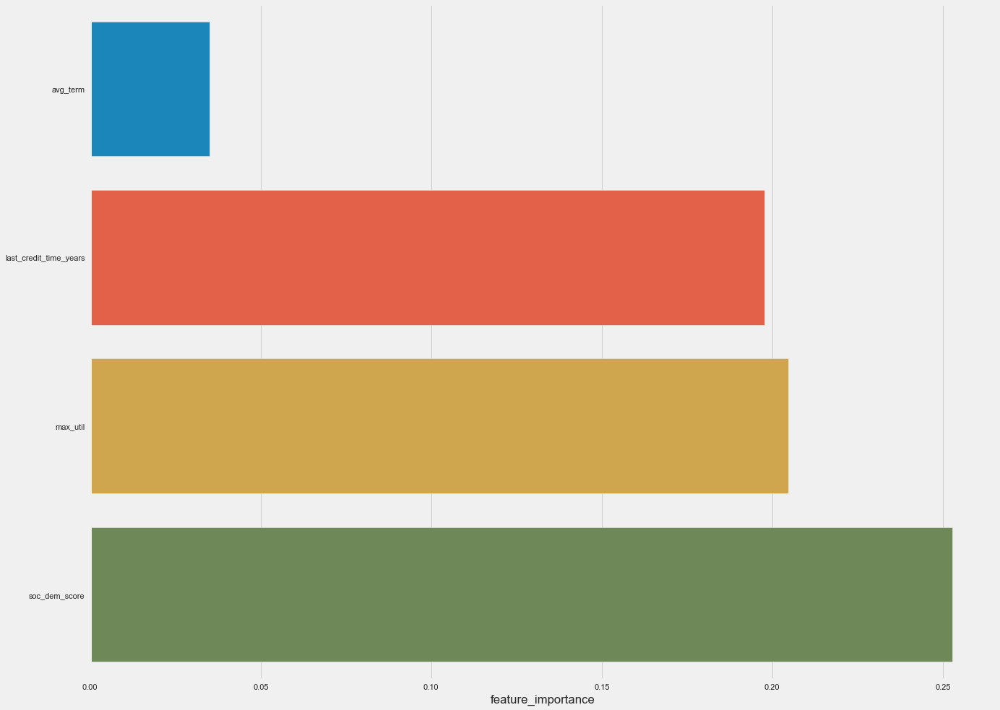

In [208]:
coef = pd.DataFrame(log_reg.coef_[0],index=best_stepwise, columns=['feature_importance']).sort_values(by=['feature_importance'])
plot = sns.barplot(y=coef.index, x=coef['feature_importance'])
plot.figure.set_size_inches(20, 16)

### Задание 11

Результаты бустинга и линейной модели различаются в определённых аспектах, если у бустинга был явный перевес в сторону max_util, то у линейной модели три самых сильных признака имеют схожие веса. Два самых сильных признака совпадают и там и там, правда в разном порядке. Но не смотря на это avg_term и last_credit_time_years находятся внизу списка важности у бустинга. Заключая, списки важности для моделей имеют немало различий, которые обусловлены, как мне кажется, в основном различными подходами к обучению и струкрой подходов вцелом. Если бустинг использует деревья, которые на каждом шаге отбирают по одному самому важному признаку, то линейная модель находит в многомерном пространстве оптимизирующие функцию потерь вектора, используя тем самым всю информацию сразу. Это , как мне кажется, является одной из самых важных причин , почему мы получили явный перевес в сторону одного признака у бустинга

### Задания 12

Посчитаем Roc Auc для Бустинга

In [167]:
estimator = lgb.LGBMClassifier(lambda_l1 = 20,lambda_l2 = 5, learning_rate = 0.0934,max_depth = 4, min_data_in_leaf = 250, n_estimators = 3500,random_state = 42)
estimator.fit(train_data,train_labels)

In [169]:
print("Train score:", roc_auc_score(train_labels,estimator.predict_proba(train_data)[:,1]))
print("Validation score:", roc_auc_score(val_labels,estimator.predict_proba(val_data)[:,1]))
print("Test score:", roc_auc_score(test_labels,estimator.predict_proba(test_data)[:,1]))

Train score: 0.7124592442360349
Validation score: 0.6640915547939515
Test score: 0.6473105357967334


Если мы теперь обучимся на train + validation, то получим результат на test 0.65

In [233]:
train_val_data = df[features][(df['sample_part'] == 'train') | (df['sample_part'] == 'validation')]
train_val_labels = df['d4p12'][(df['sample_part'] == 'train') | (df['sample_part'] == 'validation')]

In [234]:
estimator1 = lgb.LGBMClassifier(lambda_l1 = 20,lambda_l2 = 5, learning_rate = 0.0934,max_depth = 4, min_data_in_leaf = 250, n_estimators = 3500,random_state = 42)
estimator1.fit(train_val_data,train_val_labels)

In [235]:
print("Train score:", roc_auc_score(train_labels,estimator1.predict_proba(train_data)[:,1]))
print("Validation score:", roc_auc_score(val_labels,estimator1.predict_proba(val_data)[:,1]))
print("Test score:", roc_auc_score(test_labels,estimator1.predict_proba(test_data)[:,1]))

Train score: 0.7119868516302752
Validation score: 0.6980442384616156
Test score: 0.6507245929502993


Посчитаем Roc Auc для Логистической регрессии, так как мы уже подобрали парамметры, мы можем обучить модель train + validation и получить результат на test 0.5994

In [243]:
log_reg = LogisticRegression(tol=0.0072,
                             C=0.001,
                             fit_intercept=True,
                             max_iter=1500)

In [242]:
scaler = StandardScaler()
train_data_sc = scaler.fit_transform(train_data[best_stepwise])
val_data_sc = scaler.transform(val_data[best_stepwise])
test_data_sc = scaler.transform(test_data[best_stepwise])

train_val_data_sc = scaler.transform(train_val_data[best_stepwise])

In [241]:
log_reg.fit(train_val_data_sc,train_val_labels)

In [240]:
print("Значение roc_auc на train для линейной модели:",roc_auc_score(train_labels,log_reg.predict_proba(train_data_sc)[:,1]))
print("Значение roc_auc на validation для линейной модели:",roc_auc_score(val_labels,log_reg.predict_proba(val_data_sc)[:,1]))
print("Значение roc_auc на test для линейной модели:",roc_auc_score(test_labels,log_reg.predict_proba(test_data_sc)[:,1]))

Значение roc_auc на train для линейной модели: 0.6402296004491432
Значение roc_auc на validation для линейной модели: 0.6100591349748816
Значение roc_auc на test для линейной модели: 0.5994285134359845|


Почти каждая модель в той или иной степени работает лучше на данных, на которых она обучалась, иногда это никак не влияет на дальнейшие предсказания, а в каких-то случаях модель заметно ухудшается. В нашем случае если модели и переобучились, то не сильно, это можно заметить по результатам полученым на train,validation,test, пускай они и отличаются, но в пределах допустимого. Кроме того я пытался использовать некоторые приемы, которые бы помогли справиться с переобучением (например : добавить регуляризацию, ограничить небольшим числом глубину деревьев и тд). Кроме того, логистическая регрессия обучалась на 4 признака, что тоже снижает шанс переобучения, по сравнению с обучением на всех признаках

В качестве эксперимента попробуем усреднить предсказания полученных моделей и посмотреть на результат

In [246]:
all_pred_test = (log_reg.predict_proba(test_data_sc)[:,1]+estimator.predict_proba(test_data)[:,1])/2

In [247]:
roc_auc_score(test_labels,all_pred_test)

0.6393487754967806


Результат объединения получился хуже чем, у бустинга, но в то же время разбросы ошибок каждой модели компенсируют друг друга, тем самым предавая большую уверенность модели. Если сравнивать бустинг и логистическую регрессию, то как мне кажется, преимущество со сторону бустинга не случайно. Ведь, как мне кажется, бустинг является куда более мощным инструментом, плюс, для хорошей работы логистической регресси должно выполняться куда больше дополнительных условий, но не смотря на это, её результат не сильно уступил бустингу.

                                       🎉🎉🎉Конец🎉🎉🎉